In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pickle,random,os,cv2
from sklearn.metrics import roc_auc_score

def moving_avg(X,belta=0.25):
    Y=X.copy()
    for i in range(X.shape[0]):
        if i >= 1:
            Y[i]=belta*Y[i]+(1-belta)*Y[i-1]
        else:
            pass
    return Y

def calculate_AUROC(MSE_FEA_List,score_lambda,ground_th,use_slide_avg=False,local_normalize=False):
    prediction=[]
    for index,(psnr1,psnr2,likelihood1,likelihood2) in enumerate(MSE_FEA_List):
        max_score=-50
        for i in range(len(psnr1)):
            score=100-np.dot(np.array([psnr1[i],psnr2[i],likelihood1[i],likelihood2[i]]),score_lambda)
            if score>max_score:
                max_score=score
        prediction.append(max_score)
    prediction=np.array(prediction)
    if use_slide_avg:
        prediction=moving_avg(prediction)
    if local_normalize:
        Length=[180,180,150,180,150,180,180,180,120,150,180,180]
        for i in range(len(Length)):
            prediction[sum(Length[0:i]):sum(Length[0:i+1])]-=np.min(prediction[sum(Length[0:i]):sum(Length[0:i+1])])
            prediction[sum(Length[0:i]):sum(Length[0:i+1])]/=max(1e-5,np.max(prediction[sum(Length[0:i]):sum(Length[0:i+1])]))
        
    else:
        prediction-=np.min(prediction)
        prediction/=max(1e-5,np.max(prediction))
    
    return roc_auc_score(ground_th,prediction), prediction

def grid_search(MSE_FEA_List,ground_th,search_step_size=0.1,local_normalize=False):
    max_lambda=None
    max_roc=-50
    prediction=None
    for i in range(int(1/search_step_size)+1):
        lambda1=search_step_size*i
        for j in range(int((1-lambda1)/search_step_size)+1):
            lambda2=search_step_size*j
            for k in range(int((1-lambda1-lambda2)/search_step_size)+1):
                lambda3=search_step_size*k
                lambda4=1-lambda1-lambda2-lambda3
                temp=np.array([lambda1,lambda2,lambda3,lambda4])
                roc, prediction=calculate_AUROC(MSE_FEA_List,temp,ground_th,local_normalize=local_normalize)
                if max_roc<roc:
                    max_roc=roc
                    max_lambda=temp
    return max_roc,max_lambda,prediction

def change_index(x):
    Length=[180,180,150,180,150,180,180,180,120,150,180,180]
    for i in range(len(Length)):
        if sum(Length[0:i])>=x:
            return i,x-sum(Length[0:i-1])+1

In [2]:
arr=np.load('dataset/frame_labels_ped2.npy')
with open(r"output/pkl/MSE_FEA_List.pkl", "rb") as f:    
    MSE_FEA_List=pickle.load(f)
print(arr.shape, len(MSE_FEA_List))

remove_10=False
if remove_10:
    Result=[]
    ground_th=[]
    Length=[180,180,150,180,150,180,180,180,120,150,180,180]
    for i in range(len(Length)):
        Result.extend(MSE_FEA_List[sum(Length[0:i])+9:sum(Length[0:i+1])])
        ground_th.extend(arr[0][sum(Length[0:i])+9:sum(Length[0:i+1])])
else:
    Result=MSE_FEA_List
    ground_th=arr[0]
print(len(Result),len(ground_th))

(1, 2010) 2010
2010 2010


In [3]:
a=0;b=2010
print("SI+DAE AUROC: ",calculate_AUROC(Result[a:b],np.array([1,0,0,0]),ground_th[a:b])[0])
print("DI+DAE AUROC: ",calculate_AUROC(Result[a:b],np.array([0,1,0,0]),ground_th[a:b])[0])
print("SI+GMM AUROC: ",calculate_AUROC(Result[a:b],np.array([0,0,1,0]),ground_th[a:b])[0])
print("DI+GMM AUROC: ",calculate_AUROC(Result[a:b],np.array([0,0,0,1]),ground_th[a:b])[0])
max_roc,best_lambda,prediction=grid_search(Result[a:b],ground_th[a:b])
print("max AUROC:",max_roc,"; best lambda:",'[ %.3f , %.3f , %.3f , %.3f ]'%(best_lambda[0],best_lambda[1],best_lambda[2],best_lambda[3]))
slide_avg_score,slide_avg_pre=calculate_AUROC(Result[a:b],best_lambda,ground_th[a:b],use_slide_avg=True)
print("max AUROC after sliding average: ", slide_avg_score)


SI+DAE AUROC:  0.8912644826476426
DI+DAE AUROC:  0.8996523494072842
SI+GMM AUROC:  0.6173387799710347
DI+GMM AUROC:  0.7592108968513651
max AUROC: 0.8999306039800461 ; best lambda: [ 0.100 , 0.900 , 0.000 , 0.000 ]
max AUROC after sliding average:  0.9345900606125623


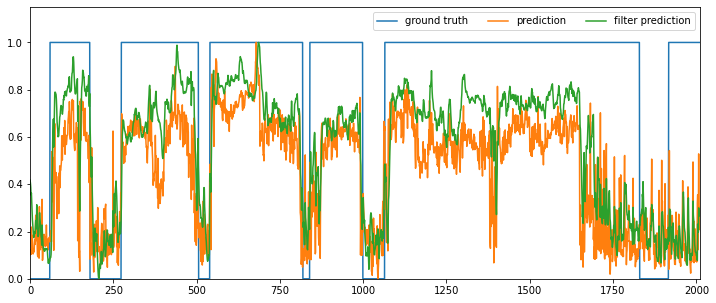

In [4]:
a=0;b=2010
plt.figure(figsize=(12,5))
plt.plot(np.arange(a,b,1),ground_th[a:b])
plt.plot(np.arange(a,b,1),prediction[a:b])
plt.plot(np.arange(a,b,1),slide_avg_pre[a:b])
plt.axis([a,b,0,1.15])
plt.legend(labels=['ground truth','prediction','filter prediction'],loc="upper right",ncol=3)

AUROC: 0.6173387799710347


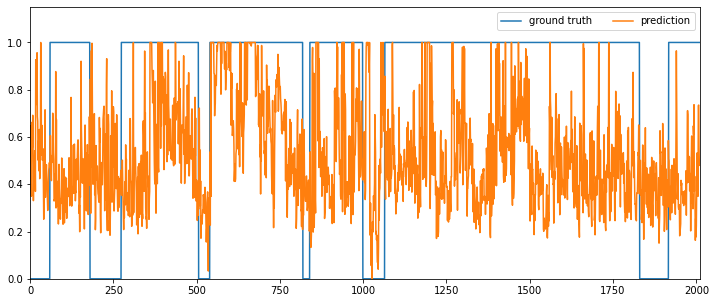

In [6]:
a=0;b=2010
lambdas=np.array([0,0,1,0])
print("AUROC:",calculate_AUROC(Result[a:b],lambdas,ground_th[a:b])[0])
plt.figure(figsize=(12,5))
plt.plot(np.arange(a,b,1),ground_th[a:b])
plt.plot(np.arange(a,b,1),calculate_AUROC(Result[a:b],lambdas,ground_th[a:b])[1][a:b])
plt.axis([a,b,0,1.15])
plt.legend(labels=['ground truth','prediction','filter prediction'],loc="upper right",ncol=3)

In [70]:
change_index(1750)

(11, 101)

Vis Feature

In [7]:
from time import time

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.ticker import NullFormatter

from sklearn import manifold, datasets

def visualize_latent_feature(MSE_FEA_List,SI_fea,DI_fea,score_type='psnr1'):
    assert score_type in ['psnr1','psnr2','likelihood1','likelihood2'],"score type must be psnr1-2 or likelihood1-2"
    prediction=[]
    for index,(psnr1,psnr2,likelihood1,likelihood2) in enumerate(MSE_FEA_List):
        for i in range(len(psnr1)):
            if score_type=='psnr1':
                prediction.append(0-psnr1[i])
            elif score_type=='psnr2':
                prediction.append(0-psnr2[i])
            elif score_type=='likelihood1':
                prediction.append(0-likelihood1[i])
            elif score_type=='likelihood2':
                prediction.append(0-likelihood2[i])
    prediction=np.array(prediction)
    prediction-=np.min(prediction)
    prediction/=max(1e-5,np.max(prediction))
    SI_fea=np.array(SI_fea)
    DI_fea=np.array(DI_fea)
    assert prediction.shape[0]==SI_fea.shape[0]==DI_fea.shape[0], "sample length must be same!"
    t0 = time()
    tsne = manifold.TSNE(n_components=2, init='pca', random_state=0)
    if score_type[-1]=="1":
        Y = tsne.fit_transform(SI_fea) 
    else:
        Y = tsne.fit_transform(DI_fea)
    t1 = time()
    print("t-SNE: %.2g sec" % (t1 - t0)) 
    return Y,prediction

def show_2d_coordinate(coord1,color1,coord2,color2,coord3,color3,coord4,color4):
    fig=plt.figure(figsize=(14,14))
    ax1 = fig.add_subplot(221)
    ax1.scatter(coord1[:, 0], coord1[:, 1], s=1, c=color1, cmap=plt.cm.jet)

    ax2 = fig.add_subplot(222)
    ax2.scatter(coord2[:, 0], coord2[:, 1], s=1, c=color2, cmap=plt.cm.jet)

    ax3 = fig.add_subplot(223)
    ax3.scatter(coord3[:, 0], coord3[:, 1], s=1, c=color3, cmap=plt.cm.jet)

    ax4 = fig.add_subplot(224)
    ax4.scatter(coord4[:, 0], coord4[:, 1], s=1, c=color4, cmap=plt.cm.jet)

    plt.show()

In [8]:
with open(r"output/pkl/MSE_FEA_List.pkl", "rb") as f:    
    MSE_FEA_List=pickle.load(f)
with open(r"output/pkl/SI_FEATURE.pkl", "rb") as f:    
    SI_fea=pickle.load(f)
with open(r"output/pkl/DI_FEATURE.pkl", "rb") as f:    
    DI_fea=pickle.load(f)

latent_coord1,score1=visualize_latent_feature(MSE_FEA_List,SI_fea,DI_fea,score_type="psnr1")
latent_coord2,score2=visualize_latent_feature(MSE_FEA_List,SI_fea,DI_fea,score_type="psnr2")
latent_coord3,score3=visualize_latent_feature(MSE_FEA_List,SI_fea,DI_fea,score_type="likelihood1")
latent_coord4,score4=visualize_latent_feature(MSE_FEA_List,SI_fea,DI_fea,score_type="likelihood2")

t-SNE: 1.9e+02 sec
t-SNE: 1.9e+02 sec
t-SNE: 1.9e+02 sec
t-SNE: 1.9e+02 sec


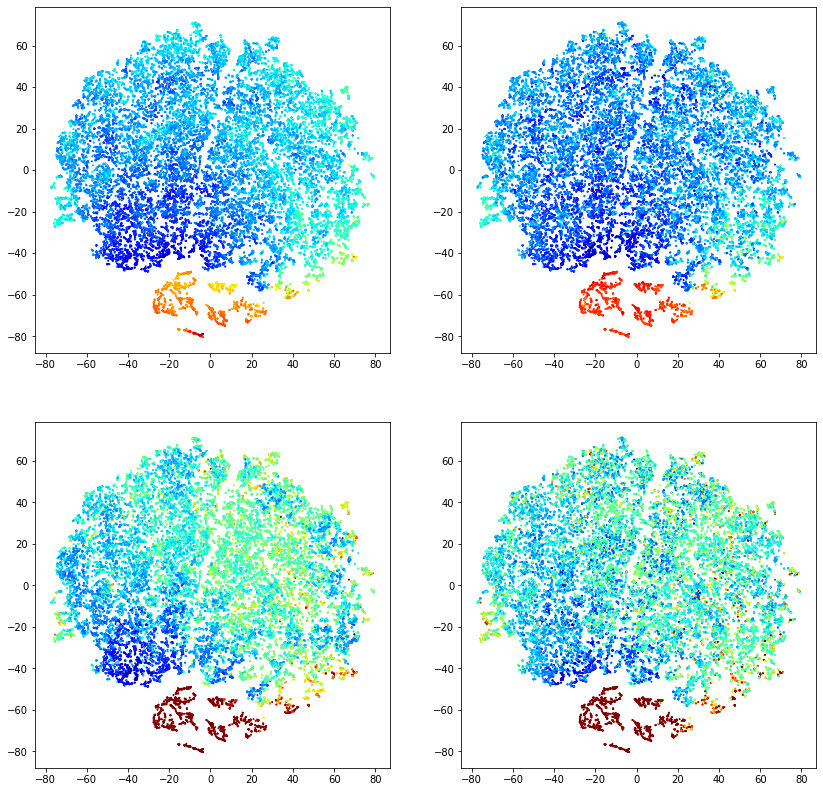

In [9]:
show_2d_coordinate(latent_coord1,score1,latent_coord2,score2,latent_coord3,score3,latent_coord4,score4)

In [60]:
"psnr1"[0:-1]

'psnr'

Vis pre-process

In [11]:

from PIL import Image
from torchvision import transforms as T

img=Image.open("1.jpg").convert('L')
print(img.size)
temp=int((img.size[1]-img.size[0])/2)
pad=(temp,0) if temp>=0 else (0,-temp)
transform=T.Compose([T.Pad(pad,fill=0), T.Resize((64,64), Image.ANTIALIAS)])
img=transform(img)
print(img.size)
img.save("2.jpg")

(18, 31)
(64, 64)


Show dynamic curve

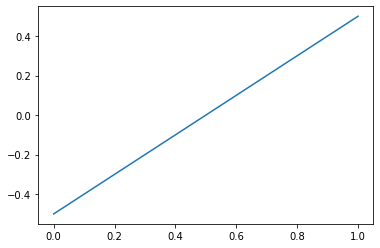

In [19]:
file_list=os.listdir("temp")
Frames=[]
for item in file_list:
    img=cv2.imread(os.path.join("temp",item))
    Frames.append(img) #t10:[145:175,53:73], t1:[144:175,44:60]

T=2
dimg=np.zeros(Frames[0].shape)
alpha=[]
for i in range(1,T+1):
    temp=0
    for j in range(i,T+1):
        temp+=(2*j-T-1)/(j)
    alpha.append(temp)
    dimg+=(Frames[i-1]/255)*temp
dimg -= (dimg[np.unravel_index(dimg.argmin(), dimg.shape)])
dimg /= (dimg[np.unravel_index(dimg.argmax(), dimg.shape)])
dimg *= 255
cv2.imwrite("1.jpg",dimg)
plt.plot(alpha)


Confirm ground truth

In [69]:
import scipy.io as scio

data = scio.loadmat("dataset/ped2.mat")
Length=[180,180,150,180,150,180,180,180,120,150,180,180]
GT=np.array([0 for _ in range(2010)])
for i in range(12):
    a=data['gt'][0][i][0][0]-1+sum(Length[0:i])
    b=data['gt'][0][i][1][0]+sum(Length[0:i])
    for j in range(a,b):
        GT[j]=1

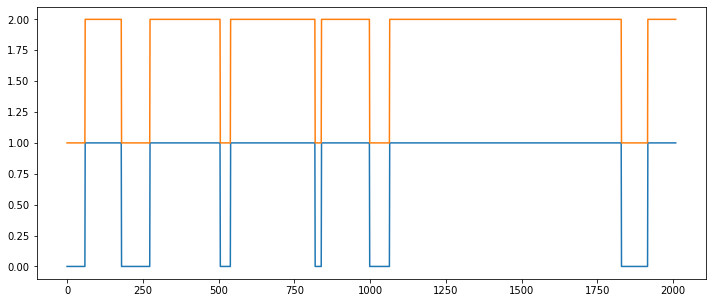

In [75]:
plt.figure(figsize=(12,5))
plt.plot(GT)
plt.plot(ground_th+1)

T-SNE

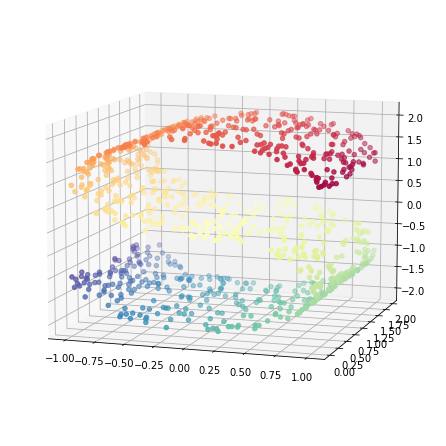

'绘制S曲线的3D图像'

In [17]:
from time import time

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.ticker import NullFormatter

from sklearn import manifold, datasets

# # Next line to silence pyflakes. This import is needed.
# Axes3D

n_points = 1000
# X是一个(1000, 3)的2维数据，color是一个(1000,)的1维数据
X, color = datasets.make_s_curve(n_points, random_state=0)
n_neighbors = 10
n_components = 2

fig=plt.figure(figsize=(6,6))
ax=Axes3D(fig)
ax.scatter(X[:, 0], X[:, 1], X[:, 2], c=color, cmap=plt.cm.Spectral)
ax.view_init(10, -72)
plt.show()

'''绘制S曲线的3D图像'''

t-SNE: 2.6 sec


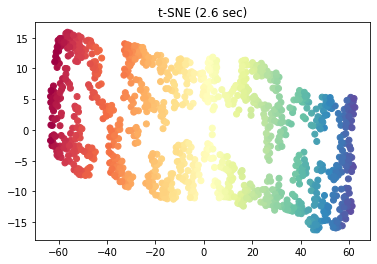

In [18]:
'''t-SNE'''
t0 = time()
tsne = manifold.TSNE(n_components=n_components, init='pca', random_state=0)
Y = tsne.fit_transform(X)  # 转换后的输出
t1 = time()
print("t-SNE: %.2g sec" % (t1 - t0))  # 算法用时
ax = fig.add_subplot(1, 1, 1)
plt.scatter(Y[:, 0], Y[:, 1], c=color, cmap=plt.cm.Spectral)
plt.title("t-SNE (%.2g sec)" % (t1 - t0))
ax.xaxis.set_major_formatter(NullFormatter())  # 设置标签显示格式为空
ax.yaxis.set_major_formatter(NullFormatter())

In [9]:
import numpy as np
x=np.array([1,2,3,4])
F=np.linalg.norm(x)

In [11]:
F**2

30.0

In [12]:
1+4+9+16

30